In [1]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import sys
sys.path.insert(0, '../')

In [4]:
os.environ['CUDA_VISIBLE_DEVICES'] = '1,2'

# Training using the ResNet topology

In [5]:
from cpe775.networks.resnet import resnet34

In [6]:
net = resnet34(in_shape=(-1, 1, 224, 224), out_shape=(-1, 68, 2))

## Loading the dataset and splitting between train and valid

In [7]:
from cpe775.dataset import FaceLandmarksDataset, CroppedFaceLandmarksDataset
from torch.utils.data.sampler import SubsetRandomSampler
from torchvision.transforms import Compose
from cpe775.transforms import ToTensor, CropFace, ToGray, RandomHorizontalFlip, ToPILImage, RandomCrop, CenterCrop

In [8]:
batch_size = 128
random_seed = 42
valid_size = 0.2
shuffle = True

In [9]:
train_transforms = Compose([
                   ToPILImage(),
                   RandomCrop((224,224)),
                   RandomHorizontalFlip(),
                   ToGray(),
                   ToTensor()
                 ])

transforms = Compose([
                   ToPILImage(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [10]:
# load the dataset
train_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=train_transforms)
valid_dataset = CroppedFaceLandmarksDataset(data_file='../data/train.npz',
                                            transform=transforms)

num_train = len(train_dataset)
indices = list(range(num_train))
split = int(np.floor(valid_size * num_train))

if shuffle == True:
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

train_loader = torch.utils.data.DataLoader(train_dataset, 
                batch_size=batch_size, sampler=train_sampler, num_workers=4)

valid_loader = torch.utils.data.DataLoader(valid_dataset, 
                batch_size=batch_size, sampler=valid_sampler, num_workers=4)

## Creating the model

In [11]:
net = torch.nn.DataParallel(net)
net = net.cuda()

In [12]:
np.sum([v.numel() for v in net.parameters()])

2237496

## Creating the loss function

In [13]:
import torch
from cpe775.criterion import NRMSELoss
from cpe775.model import Model
from cpe775 import callbacks

In [14]:
criterion = NRMSELoss()
criterion = criterion.cuda()

In [15]:
optimizer = torch.optim.SGD(net.parameters(), 0.05, momentum=0.9)
model = Model(net, criterion=criterion)
model.set_optimizer(optimizer)

## Training

In [16]:
from torch.optim.lr_scheduler import MultiStepLR
from cpe775 import metrics

In [17]:
callback_list = [
        callbacks.Progbar(print_freq=40),
        callbacks.ModelCheckpoint('../results/resnet/resnet-34-1c.pth.tar', 'val_loss', mode='min'),
        callbacks.LearningRateScheduler(MultiStepLR(optimizer, milestones=[750,900], gamma=0.1))
    ]

In [18]:
model.fit_loader(train_loader, 1000, val_loader=valid_loader,
                 callback=callbacks.Compose(callback_list), metrics={'rmse': NRMSELoss(weight=68)})

Epoch: [0][0/20]	Time 6.302 (6.302)	Data 0.193 (0.193)	Train Loss 4.860 (4.860)	Train Rmse 330.447 (330.447)	
Val: [0/5]	Time 0.303 (0.303)	Data 0.260 (0.260)	Val Loss 50.841 (50.841)	Val Rmse 3457.222 (3457.222)	
Epoch: [1][0/20]	Time 0.424 (0.424)	Data 0.324 (0.324)	Train Loss 0.685 (0.685)	Train Rmse 46.576 (46.576)	
Val: [0/5]	Time 0.356 (0.356)	Data 0.279 (0.279)	Val Loss 15.236 (15.236)	Val Rmse 1036.077 (1036.077)	
Epoch: [2][0/20]	Time 0.386 (0.386)	Data 0.273 (0.273)	Train Loss 0.795 (0.795)	Train Rmse 54.054 (54.054)	
Val: [0/5]	Time 0.380 (0.380)	Data 0.295 (0.295)	Val Loss 0.770 (0.770)	Val Rmse 52.377 (52.377)	
Epoch: [3][0/20]	Time 0.366 (0.366)	Data 0.265 (0.265)	Train Loss 0.426 (0.426)	Train Rmse 28.993 (28.993)	
Val: [0/5]	Time 0.350 (0.350)	Data 0.270 (0.270)	Val Loss 0.399 (0.399)	Val Rmse 27.118 (27.118)	
Epoch: [4][0/20]	Time 0.369 (0.369)	Data 0.277 (0.277)	Train Loss 0.409 (0.409)	Train Rmse 27.806 (27.806)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.307 (0.307)	Val L

Epoch: [40][0/20]	Time 0.409 (0.409)	Data 0.294 (0.294)	Train Loss 0.149 (0.149)	Train Rmse 10.104 (10.104)	
Val: [0/5]	Time 0.415 (0.415)	Data 0.310 (0.310)	Val Loss 0.145 (0.145)	Val Rmse 9.867 (9.867)	
Epoch: [41][0/20]	Time 0.426 (0.426)	Data 0.310 (0.310)	Train Loss 0.142 (0.142)	Train Rmse 9.646 (9.646)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.309 (0.309)	Val Loss 0.164 (0.164)	Val Rmse 11.184 (11.184)	
Epoch: [42][0/20]	Time 0.430 (0.430)	Data 0.303 (0.303)	Train Loss 0.161 (0.161)	Train Rmse 10.965 (10.965)	
Val: [0/5]	Time 0.310 (0.310)	Data 0.271 (0.271)	Val Loss 0.129 (0.129)	Val Rmse 8.742 (8.742)	
Epoch: [43][0/20]	Time 0.440 (0.440)	Data 0.307 (0.307)	Train Loss 0.141 (0.141)	Train Rmse 9.616 (9.616)	
Val: [0/5]	Time 0.372 (0.372)	Data 0.303 (0.303)	Val Loss 0.236 (0.236)	Val Rmse 16.030 (16.030)	
Epoch: [44][0/20]	Time 0.381 (0.381)	Data 0.254 (0.254)	Train Loss 0.235 (0.235)	Train Rmse 15.981 (15.981)	
Val: [0/5]	Time 0.349 (0.349)	Data 0.287 (0.287)	Val Loss 0.124 (0.124)

Val: [0/5]	Time 0.301 (0.301)	Data 0.250 (0.250)	Val Loss 0.101 (0.101)	Val Rmse 6.873 (6.873)	
Epoch: [81][0/20]	Time 0.392 (0.392)	Data 0.300 (0.300)	Train Loss 0.100 (0.100)	Train Rmse 6.816 (6.816)	
Val: [0/5]	Time 0.458 (0.458)	Data 0.356 (0.356)	Val Loss 0.096 (0.096)	Val Rmse 6.505 (6.505)	
Epoch: [82][0/20]	Time 0.434 (0.434)	Data 0.309 (0.309)	Train Loss 0.102 (0.102)	Train Rmse 6.945 (6.945)	
Val: [0/5]	Time 0.382 (0.382)	Data 0.300 (0.300)	Val Loss 0.106 (0.106)	Val Rmse 7.219 (7.219)	
Epoch: [83][0/20]	Time 0.562 (0.562)	Data 0.398 (0.398)	Train Loss 0.116 (0.116)	Train Rmse 7.911 (7.911)	
Val: [0/5]	Time 0.327 (0.327)	Data 0.266 (0.266)	Val Loss 0.105 (0.105)	Val Rmse 7.113 (7.113)	
Epoch: [84][0/20]	Time 0.465 (0.465)	Data 0.357 (0.357)	Train Loss 0.113 (0.113)	Train Rmse 7.678 (7.678)	
Val: [0/5]	Time 0.337 (0.337)	Data 0.251 (0.251)	Val Loss 0.111 (0.111)	Val Rmse 7.569 (7.569)	
Epoch: [85][0/20]	Time 0.397 (0.397)	Data 0.279 (0.279)	Train Loss 0.118 (0.118)	Train Rmse 

Epoch: [121][0/20]	Time 0.469 (0.469)	Data 0.335 (0.335)	Train Loss 0.095 (0.095)	Train Rmse 6.449 (6.449)	
Val: [0/5]	Time 0.317 (0.317)	Data 0.257 (0.257)	Val Loss 0.083 (0.083)	Val Rmse 5.613 (5.613)	
Epoch: [122][0/20]	Time 0.566 (0.566)	Data 0.373 (0.373)	Train Loss 0.082 (0.082)	Train Rmse 5.573 (5.573)	
Val: [0/5]	Time 0.329 (0.329)	Data 0.284 (0.284)	Val Loss 0.090 (0.090)	Val Rmse 6.094 (6.094)	
Epoch: [123][0/20]	Time 0.383 (0.383)	Data 0.298 (0.298)	Train Loss 0.091 (0.091)	Train Rmse 6.197 (6.197)	
Val: [0/5]	Time 0.434 (0.434)	Data 0.333 (0.333)	Val Loss 0.089 (0.089)	Val Rmse 6.047 (6.047)	
Epoch: [124][0/20]	Time 0.480 (0.480)	Data 0.318 (0.318)	Train Loss 0.098 (0.098)	Train Rmse 6.638 (6.638)	
Val: [0/5]	Time 0.510 (0.510)	Data 0.421 (0.421)	Val Loss 0.112 (0.112)	Val Rmse 7.596 (7.596)	
Epoch: [125][0/20]	Time 0.476 (0.476)	Data 0.373 (0.373)	Train Loss 0.094 (0.094)	Train Rmse 6.382 (6.382)	
Val: [0/5]	Time 0.310 (0.310)	Data 0.241 (0.241)	Val Loss 0.097 (0.097)	Val 

Val: [0/5]	Time 0.391 (0.391)	Data 0.282 (0.282)	Val Loss 0.104 (0.104)	Val Rmse 7.038 (7.038)	
Epoch: [162][0/20]	Time 0.449 (0.449)	Data 0.323 (0.323)	Train Loss 0.092 (0.092)	Train Rmse 6.270 (6.270)	
Val: [0/5]	Time 0.461 (0.461)	Data 0.376 (0.376)	Val Loss 0.082 (0.082)	Val Rmse 5.596 (5.596)	
Epoch: [163][0/20]	Time 0.501 (0.501)	Data 0.372 (0.372)	Train Loss 0.081 (0.081)	Train Rmse 5.494 (5.494)	
Val: [0/5]	Time 0.380 (0.380)	Data 0.301 (0.301)	Val Loss 0.086 (0.086)	Val Rmse 5.881 (5.881)	
Epoch: [164][0/20]	Time 0.441 (0.441)	Data 0.307 (0.307)	Train Loss 0.091 (0.091)	Train Rmse 6.191 (6.191)	
Val: [0/5]	Time 0.430 (0.430)	Data 0.356 (0.356)	Val Loss 0.084 (0.084)	Val Rmse 5.716 (5.716)	
Epoch: [165][0/20]	Time 0.481 (0.481)	Data 0.346 (0.346)	Train Loss 0.090 (0.090)	Train Rmse 6.138 (6.138)	
Val: [0/5]	Time 0.396 (0.396)	Data 0.312 (0.312)	Val Loss 0.076 (0.076)	Val Rmse 5.180 (5.180)	
Epoch: [166][0/20]	Time 0.419 (0.419)	Data 0.327 (0.327)	Train Loss 0.079 (0.079)	Train 

Epoch: [202][0/20]	Time 0.434 (0.434)	Data 0.300 (0.300)	Train Loss 0.082 (0.082)	Train Rmse 5.581 (5.581)	
Val: [0/5]	Time 0.441 (0.441)	Data 0.358 (0.358)	Val Loss 0.074 (0.074)	Val Rmse 5.040 (5.040)	
Epoch: [203][0/20]	Time 0.522 (0.522)	Data 0.377 (0.377)	Train Loss 0.075 (0.075)	Train Rmse 5.101 (5.101)	
Val: [0/5]	Time 0.307 (0.307)	Data 0.253 (0.253)	Val Loss 0.082 (0.082)	Val Rmse 5.544 (5.544)	
Epoch: [204][0/20]	Time 0.349 (0.349)	Data 0.253 (0.253)	Train Loss 0.082 (0.082)	Train Rmse 5.543 (5.543)	
Val: [0/5]	Time 0.421 (0.421)	Data 0.343 (0.343)	Val Loss 0.077 (0.077)	Val Rmse 5.240 (5.240)	
Epoch: [205][0/20]	Time 0.520 (0.520)	Data 0.356 (0.356)	Train Loss 0.084 (0.084)	Train Rmse 5.685 (5.685)	
Val: [0/5]	Time 0.329 (0.329)	Data 0.275 (0.275)	Val Loss 0.078 (0.078)	Val Rmse 5.309 (5.309)	
Epoch: [206][0/20]	Time 0.400 (0.400)	Data 0.274 (0.274)	Train Loss 0.085 (0.085)	Train Rmse 5.772 (5.772)	
Val: [0/5]	Time 0.392 (0.392)	Data 0.296 (0.296)	Val Loss 0.080 (0.080)	Val 

Val: [0/5]	Time 0.320 (0.320)	Data 0.261 (0.261)	Val Loss 0.088 (0.088)	Val Rmse 5.964 (5.964)	
Epoch: [243][0/20]	Time 0.449 (0.449)	Data 0.340 (0.340)	Train Loss 0.073 (0.073)	Train Rmse 4.982 (4.982)	
Val: [0/5]	Time 0.368 (0.368)	Data 0.290 (0.290)	Val Loss 0.077 (0.077)	Val Rmse 5.222 (5.222)	
Epoch: [244][0/20]	Time 0.428 (0.428)	Data 0.320 (0.320)	Train Loss 0.076 (0.076)	Train Rmse 5.157 (5.157)	
Val: [0/5]	Time 0.439 (0.439)	Data 0.348 (0.348)	Val Loss 0.072 (0.072)	Val Rmse 4.886 (4.886)	
Epoch: [245][0/20]	Time 0.406 (0.406)	Data 0.275 (0.275)	Train Loss 0.071 (0.071)	Train Rmse 4.836 (4.836)	
Val: [0/5]	Time 0.473 (0.473)	Data 0.300 (0.300)	Val Loss 0.085 (0.085)	Val Rmse 5.783 (5.783)	
Epoch: [246][0/20]	Time 0.489 (0.489)	Data 0.389 (0.389)	Train Loss 0.075 (0.075)	Train Rmse 5.088 (5.088)	
Val: [0/5]	Time 0.447 (0.447)	Data 0.348 (0.348)	Val Loss 0.086 (0.086)	Val Rmse 5.816 (5.816)	
Epoch: [247][0/20]	Time 0.455 (0.455)	Data 0.320 (0.320)	Train Loss 0.085 (0.085)	Train 

Epoch: [283][0/20]	Time 0.421 (0.421)	Data 0.300 (0.300)	Train Loss 0.073 (0.073)	Train Rmse 4.986 (4.986)	
Val: [0/5]	Time 0.399 (0.399)	Data 0.270 (0.270)	Val Loss 0.077 (0.077)	Val Rmse 5.224 (5.224)	
Epoch: [284][0/20]	Time 0.437 (0.437)	Data 0.295 (0.295)	Train Loss 0.068 (0.068)	Train Rmse 4.621 (4.621)	
Val: [0/5]	Time 0.304 (0.304)	Data 0.242 (0.242)	Val Loss 0.076 (0.076)	Val Rmse 5.145 (5.145)	
Epoch: [285][0/20]	Time 0.443 (0.443)	Data 0.344 (0.344)	Train Loss 0.075 (0.075)	Train Rmse 5.066 (5.066)	
Val: [0/5]	Time 0.430 (0.430)	Data 0.347 (0.347)	Val Loss 0.077 (0.077)	Val Rmse 5.242 (5.242)	
Epoch: [286][0/20]	Time 0.468 (0.468)	Data 0.296 (0.296)	Train Loss 0.078 (0.078)	Train Rmse 5.333 (5.333)	
Val: [0/5]	Time 0.402 (0.402)	Data 0.323 (0.323)	Val Loss 0.073 (0.073)	Val Rmse 4.980 (4.980)	
Epoch: [287][0/20]	Time 0.425 (0.425)	Data 0.321 (0.321)	Train Loss 0.072 (0.072)	Train Rmse 4.895 (4.895)	
Val: [0/5]	Time 0.354 (0.354)	Data 0.258 (0.258)	Val Loss 0.071 (0.071)	Val 

Val: [0/5]	Time 0.457 (0.457)	Data 0.374 (0.374)	Val Loss 0.071 (0.071)	Val Rmse 4.807 (4.807)	
Epoch: [324][0/20]	Time 0.409 (0.409)	Data 0.273 (0.273)	Train Loss 0.070 (0.070)	Train Rmse 4.752 (4.752)	
Val: [0/5]	Time 0.336 (0.336)	Data 0.270 (0.270)	Val Loss 0.074 (0.074)	Val Rmse 5.004 (5.004)	
Epoch: [325][0/20]	Time 0.413 (0.413)	Data 0.305 (0.305)	Train Loss 0.070 (0.070)	Train Rmse 4.790 (4.790)	
Val: [0/5]	Time 0.374 (0.374)	Data 0.273 (0.273)	Val Loss 0.079 (0.079)	Val Rmse 5.388 (5.388)	
Epoch: [326][0/20]	Time 0.444 (0.444)	Data 0.325 (0.325)	Train Loss 0.071 (0.071)	Train Rmse 4.794 (4.794)	
Val: [0/5]	Time 0.499 (0.499)	Data 0.330 (0.330)	Val Loss 0.078 (0.078)	Val Rmse 5.327 (5.327)	
Epoch: [327][0/20]	Time 0.442 (0.442)	Data 0.318 (0.318)	Train Loss 0.069 (0.069)	Train Rmse 4.685 (4.685)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.288 (0.288)	Val Loss 0.065 (0.065)	Val Rmse 4.432 (4.432)	
Epoch: [328][0/20]	Time 0.410 (0.410)	Data 0.319 (0.319)	Train Loss 0.070 (0.070)	Train 

Epoch: [364][0/20]	Time 0.461 (0.461)	Data 0.300 (0.300)	Train Loss 0.066 (0.066)	Train Rmse 4.513 (4.513)	
Val: [0/5]	Time 0.364 (0.364)	Data 0.303 (0.303)	Val Loss 0.069 (0.069)	Val Rmse 4.721 (4.721)	
Epoch: [365][0/20]	Time 0.370 (0.370)	Data 0.280 (0.280)	Train Loss 0.062 (0.062)	Train Rmse 4.240 (4.240)	
Val: [0/5]	Time 0.392 (0.392)	Data 0.310 (0.310)	Val Loss 0.069 (0.069)	Val Rmse 4.691 (4.691)	
Epoch: [366][0/20]	Time 0.488 (0.488)	Data 0.346 (0.346)	Train Loss 0.066 (0.066)	Train Rmse 4.486 (4.486)	
Val: [0/5]	Time 0.336 (0.336)	Data 0.265 (0.265)	Val Loss 0.066 (0.066)	Val Rmse 4.480 (4.480)	
Epoch: [367][0/20]	Time 0.405 (0.405)	Data 0.285 (0.285)	Train Loss 0.062 (0.062)	Train Rmse 4.228 (4.228)	
Val: [0/5]	Time 0.449 (0.449)	Data 0.355 (0.355)	Val Loss 0.070 (0.070)	Val Rmse 4.781 (4.781)	
Epoch: [368][0/20]	Time 0.460 (0.460)	Data 0.322 (0.322)	Train Loss 0.063 (0.063)	Train Rmse 4.268 (4.268)	
Val: [0/5]	Time 0.367 (0.367)	Data 0.278 (0.278)	Val Loss 0.072 (0.072)	Val 

Val: [0/5]	Time 0.261 (0.261)	Data 0.229 (0.229)	Val Loss 0.069 (0.069)	Val Rmse 4.695 (4.695)	
Epoch: [405][0/20]	Time 0.394 (0.394)	Data 0.290 (0.290)	Train Loss 0.064 (0.064)	Train Rmse 4.381 (4.381)	
Val: [0/5]	Time 0.392 (0.392)	Data 0.319 (0.319)	Val Loss 0.068 (0.068)	Val Rmse 4.632 (4.632)	
Epoch: [406][0/20]	Time 0.556 (0.556)	Data 0.413 (0.413)	Train Loss 0.064 (0.064)	Train Rmse 4.343 (4.343)	
Val: [0/5]	Time 0.384 (0.384)	Data 0.304 (0.304)	Val Loss 0.065 (0.065)	Val Rmse 4.421 (4.421)	
Epoch: [407][0/20]	Time 0.560 (0.560)	Data 0.404 (0.404)	Train Loss 0.063 (0.063)	Train Rmse 4.281 (4.281)	
Val: [0/5]	Time 0.374 (0.374)	Data 0.303 (0.303)	Val Loss 0.067 (0.067)	Val Rmse 4.587 (4.587)	
Epoch: [408][0/20]	Time 0.412 (0.412)	Data 0.303 (0.303)	Train Loss 0.061 (0.061)	Train Rmse 4.150 (4.150)	
Val: [0/5]	Time 0.396 (0.396)	Data 0.321 (0.321)	Val Loss 0.064 (0.064)	Val Rmse 4.375 (4.375)	
Epoch: [409][0/20]	Time 0.451 (0.451)	Data 0.339 (0.339)	Train Loss 0.062 (0.062)	Train 

Epoch: [445][0/20]	Time 0.484 (0.484)	Data 0.352 (0.352)	Train Loss 0.061 (0.061)	Train Rmse 4.153 (4.153)	
Val: [0/5]	Time 0.439 (0.439)	Data 0.337 (0.337)	Val Loss 0.071 (0.071)	Val Rmse 4.802 (4.802)	
Epoch: [446][0/20]	Time 0.504 (0.504)	Data 0.314 (0.314)	Train Loss 0.060 (0.060)	Train Rmse 4.078 (4.078)	
Val: [0/5]	Time 0.385 (0.385)	Data 0.320 (0.320)	Val Loss 0.073 (0.073)	Val Rmse 4.955 (4.955)	
Epoch: [447][0/20]	Time 0.467 (0.467)	Data 0.358 (0.358)	Train Loss 0.063 (0.063)	Train Rmse 4.279 (4.279)	
Val: [0/5]	Time 0.336 (0.336)	Data 0.280 (0.280)	Val Loss 0.068 (0.068)	Val Rmse 4.595 (4.595)	
Epoch: [448][0/20]	Time 0.485 (0.485)	Data 0.347 (0.347)	Train Loss 0.062 (0.062)	Train Rmse 4.217 (4.217)	
Val: [0/5]	Time 0.405 (0.405)	Data 0.331 (0.331)	Val Loss 0.068 (0.068)	Val Rmse 4.601 (4.601)	
Epoch: [449][0/20]	Time 0.384 (0.384)	Data 0.306 (0.306)	Train Loss 0.061 (0.061)	Train Rmse 4.118 (4.118)	
Val: [0/5]	Time 0.401 (0.401)	Data 0.317 (0.317)	Val Loss 0.076 (0.076)	Val 

Val: [0/5]	Time 0.350 (0.350)	Data 0.269 (0.269)	Val Loss 0.068 (0.068)	Val Rmse 4.640 (4.640)	
Epoch: [486][0/20]	Time 0.513 (0.513)	Data 0.390 (0.390)	Train Loss 0.060 (0.060)	Train Rmse 4.072 (4.072)	
Val: [0/5]	Time 0.453 (0.453)	Data 0.375 (0.375)	Val Loss 0.070 (0.070)	Val Rmse 4.746 (4.746)	
Epoch: [487][0/20]	Time 0.438 (0.438)	Data 0.278 (0.278)	Train Loss 0.060 (0.060)	Train Rmse 4.095 (4.095)	
Val: [0/5]	Time 0.350 (0.350)	Data 0.266 (0.266)	Val Loss 0.072 (0.072)	Val Rmse 4.887 (4.887)	
Epoch: [488][0/20]	Time 0.538 (0.538)	Data 0.338 (0.338)	Train Loss 0.060 (0.060)	Train Rmse 4.053 (4.053)	
Val: [0/5]	Time 0.366 (0.366)	Data 0.304 (0.304)	Val Loss 0.064 (0.064)	Val Rmse 4.322 (4.322)	
Epoch: [489][0/20]	Time 0.565 (0.565)	Data 0.354 (0.354)	Train Loss 0.058 (0.058)	Train Rmse 3.954 (3.954)	
Val: [0/5]	Time 0.418 (0.418)	Data 0.333 (0.333)	Val Loss 0.071 (0.071)	Val Rmse 4.840 (4.840)	
Epoch: [490][0/20]	Time 0.405 (0.405)	Data 0.288 (0.288)	Train Loss 0.063 (0.063)	Train 

Epoch: [526][0/20]	Time 0.341 (0.341)	Data 0.241 (0.241)	Train Loss 0.062 (0.062)	Train Rmse 4.182 (4.182)	
Val: [0/5]	Time 0.316 (0.316)	Data 0.259 (0.259)	Val Loss 0.063 (0.063)	Val Rmse 4.308 (4.308)	
Epoch: [527][0/20]	Time 0.388 (0.388)	Data 0.284 (0.284)	Train Loss 0.057 (0.057)	Train Rmse 3.844 (3.844)	
Val: [0/5]	Time 0.363 (0.363)	Data 0.283 (0.283)	Val Loss 0.066 (0.066)	Val Rmse 4.472 (4.472)	
Epoch: [528][0/20]	Time 0.389 (0.389)	Data 0.263 (0.263)	Train Loss 0.058 (0.058)	Train Rmse 3.937 (3.937)	
Val: [0/5]	Time 0.407 (0.407)	Data 0.325 (0.325)	Val Loss 0.065 (0.065)	Val Rmse 4.433 (4.433)	
Epoch: [529][0/20]	Time 0.303 (0.303)	Data 0.217 (0.217)	Train Loss 0.059 (0.059)	Train Rmse 4.025 (4.025)	
Val: [0/5]	Time 0.331 (0.331)	Data 0.252 (0.252)	Val Loss 0.070 (0.070)	Val Rmse 4.791 (4.791)	
Epoch: [530][0/20]	Time 0.383 (0.383)	Data 0.275 (0.275)	Train Loss 0.060 (0.060)	Train Rmse 4.080 (4.080)	
Val: [0/5]	Time 0.313 (0.313)	Data 0.245 (0.245)	Val Loss 0.068 (0.068)	Val 

Val: [0/5]	Time 0.330 (0.330)	Data 0.262 (0.262)	Val Loss 0.064 (0.064)	Val Rmse 4.355 (4.355)	
Epoch: [567][0/20]	Time 0.419 (0.419)	Data 0.307 (0.307)	Train Loss 0.058 (0.058)	Train Rmse 3.956 (3.956)	
Val: [0/5]	Time 0.333 (0.333)	Data 0.278 (0.278)	Val Loss 0.064 (0.064)	Val Rmse 4.322 (4.322)	
Epoch: [568][0/20]	Time 0.380 (0.380)	Data 0.259 (0.259)	Train Loss 0.058 (0.058)	Train Rmse 3.933 (3.933)	
Val: [0/5]	Time 0.352 (0.352)	Data 0.297 (0.297)	Val Loss 0.063 (0.063)	Val Rmse 4.271 (4.271)	
Epoch: [569][0/20]	Time 0.379 (0.379)	Data 0.266 (0.266)	Train Loss 0.060 (0.060)	Train Rmse 4.107 (4.107)	
Val: [0/5]	Time 0.327 (0.327)	Data 0.276 (0.276)	Val Loss 0.065 (0.065)	Val Rmse 4.451 (4.451)	
Epoch: [570][0/20]	Time 0.401 (0.401)	Data 0.307 (0.307)	Train Loss 0.059 (0.059)	Train Rmse 4.036 (4.036)	
Val: [0/5]	Time 0.333 (0.333)	Data 0.255 (0.255)	Val Loss 0.066 (0.066)	Val Rmse 4.460 (4.460)	
Epoch: [571][0/20]	Time 0.372 (0.372)	Data 0.271 (0.271)	Train Loss 0.056 (0.056)	Train 

Epoch: [607][0/20]	Time 0.372 (0.372)	Data 0.270 (0.270)	Train Loss 0.056 (0.056)	Train Rmse 3.802 (3.802)	
Val: [0/5]	Time 0.334 (0.334)	Data 0.226 (0.226)	Val Loss 0.063 (0.063)	Val Rmse 4.270 (4.270)	
Epoch: [608][0/20]	Time 0.365 (0.365)	Data 0.245 (0.245)	Train Loss 0.055 (0.055)	Train Rmse 3.750 (3.750)	
Val: [0/5]	Time 0.335 (0.335)	Data 0.268 (0.268)	Val Loss 0.061 (0.061)	Val Rmse 4.158 (4.158)	
Epoch: [609][0/20]	Time 0.337 (0.337)	Data 0.237 (0.237)	Train Loss 0.053 (0.053)	Train Rmse 3.620 (3.620)	
Val: [0/5]	Time 0.335 (0.335)	Data 0.270 (0.270)	Val Loss 0.067 (0.067)	Val Rmse 4.581 (4.581)	
Epoch: [610][0/20]	Time 0.373 (0.373)	Data 0.260 (0.260)	Train Loss 0.054 (0.054)	Train Rmse 3.688 (3.688)	
Val: [0/5]	Time 0.364 (0.364)	Data 0.291 (0.291)	Val Loss 0.067 (0.067)	Val Rmse 4.569 (4.569)	
Epoch: [611][0/20]	Time 0.392 (0.392)	Data 0.301 (0.301)	Train Loss 0.057 (0.057)	Train Rmse 3.849 (3.849)	
Val: [0/5]	Time 0.294 (0.294)	Data 0.260 (0.260)	Val Loss 0.068 (0.068)	Val 

Val: [0/5]	Time 0.360 (0.360)	Data 0.272 (0.272)	Val Loss 0.066 (0.066)	Val Rmse 4.508 (4.508)	
Epoch: [648][0/20]	Time 0.370 (0.370)	Data 0.265 (0.265)	Train Loss 0.056 (0.056)	Train Rmse 3.807 (3.807)	
Val: [0/5]	Time 0.317 (0.317)	Data 0.254 (0.254)	Val Loss 0.068 (0.068)	Val Rmse 4.624 (4.624)	
Epoch: [649][0/20]	Time 0.387 (0.387)	Data 0.287 (0.287)	Train Loss 0.056 (0.056)	Train Rmse 3.782 (3.782)	
Val: [0/5]	Time 0.358 (0.358)	Data 0.266 (0.266)	Val Loss 0.068 (0.068)	Val Rmse 4.619 (4.619)	
Epoch: [650][0/20]	Time 0.375 (0.375)	Data 0.283 (0.283)	Train Loss 0.055 (0.055)	Train Rmse 3.733 (3.733)	
Val: [0/5]	Time 0.270 (0.270)	Data 0.217 (0.217)	Val Loss 0.066 (0.066)	Val Rmse 4.491 (4.491)	
Epoch: [651][0/20]	Time 0.319 (0.319)	Data 0.234 (0.234)	Train Loss 0.055 (0.055)	Train Rmse 3.744 (3.744)	
Val: [0/5]	Time 0.309 (0.309)	Data 0.237 (0.237)	Val Loss 0.064 (0.064)	Val Rmse 4.332 (4.332)	
Epoch: [652][0/20]	Time 0.411 (0.411)	Data 0.305 (0.305)	Train Loss 0.059 (0.059)	Train 

Epoch: [688][0/20]	Time 0.340 (0.340)	Data 0.239 (0.239)	Train Loss 0.056 (0.056)	Train Rmse 3.828 (3.828)	
Val: [0/5]	Time 0.366 (0.366)	Data 0.281 (0.281)	Val Loss 0.063 (0.063)	Val Rmse 4.270 (4.270)	
Epoch: [689][0/20]	Time 0.418 (0.418)	Data 0.299 (0.299)	Train Loss 0.055 (0.055)	Train Rmse 3.754 (3.754)	
Val: [0/5]	Time 0.346 (0.346)	Data 0.274 (0.274)	Val Loss 0.067 (0.067)	Val Rmse 4.574 (4.574)	
Epoch: [690][0/20]	Time 0.350 (0.350)	Data 0.242 (0.242)	Train Loss 0.056 (0.056)	Train Rmse 3.783 (3.783)	
Val: [0/5]	Time 0.316 (0.316)	Data 0.242 (0.242)	Val Loss 0.067 (0.067)	Val Rmse 4.559 (4.559)	
Epoch: [691][0/20]	Time 0.393 (0.393)	Data 0.266 (0.266)	Train Loss 0.057 (0.057)	Train Rmse 3.855 (3.855)	
Val: [0/5]	Time 0.343 (0.343)	Data 0.261 (0.261)	Val Loss 0.064 (0.064)	Val Rmse 4.361 (4.361)	
Epoch: [692][0/20]	Time 0.365 (0.365)	Data 0.262 (0.262)	Train Loss 0.055 (0.055)	Train Rmse 3.744 (3.744)	
Val: [0/5]	Time 0.358 (0.358)	Data 0.277 (0.277)	Val Loss 0.064 (0.064)	Val 

Val: [0/5]	Time 0.354 (0.354)	Data 0.272 (0.272)	Val Loss 0.066 (0.066)	Val Rmse 4.472 (4.472)	
Epoch: [729][0/20]	Time 0.343 (0.343)	Data 0.267 (0.267)	Train Loss 0.056 (0.056)	Train Rmse 3.792 (3.792)	
Val: [0/5]	Time 0.319 (0.319)	Data 0.257 (0.257)	Val Loss 0.066 (0.066)	Val Rmse 4.481 (4.481)	
Epoch: [730][0/20]	Time 0.341 (0.341)	Data 0.240 (0.240)	Train Loss 0.057 (0.057)	Train Rmse 3.893 (3.893)	
Val: [0/5]	Time 0.345 (0.345)	Data 0.265 (0.265)	Val Loss 0.063 (0.063)	Val Rmse 4.279 (4.279)	
Epoch: [731][0/20]	Time 0.370 (0.370)	Data 0.270 (0.270)	Train Loss 0.054 (0.054)	Train Rmse 3.700 (3.700)	
Val: [0/5]	Time 0.342 (0.342)	Data 0.262 (0.262)	Val Loss 0.066 (0.066)	Val Rmse 4.462 (4.462)	
Epoch: [732][0/20]	Time 0.364 (0.364)	Data 0.257 (0.257)	Train Loss 0.054 (0.054)	Train Rmse 3.688 (3.688)	
Val: [0/5]	Time 0.365 (0.365)	Data 0.277 (0.277)	Val Loss 0.064 (0.064)	Val Rmse 4.368 (4.368)	
Epoch: [733][0/20]	Time 0.369 (0.369)	Data 0.270 (0.270)	Train Loss 0.054 (0.054)	Train 

Epoch: [769][0/20]	Time 0.373 (0.373)	Data 0.265 (0.265)	Train Loss 0.052 (0.052)	Train Rmse 3.561 (3.561)	
Val: [0/5]	Time 0.356 (0.356)	Data 0.305 (0.305)	Val Loss 0.063 (0.063)	Val Rmse 4.304 (4.304)	
Epoch: [770][0/20]	Time 0.342 (0.342)	Data 0.253 (0.253)	Train Loss 0.053 (0.053)	Train Rmse 3.571 (3.571)	
Val: [0/5]	Time 0.350 (0.350)	Data 0.269 (0.269)	Val Loss 0.062 (0.062)	Val Rmse 4.196 (4.196)	
Epoch: [771][0/20]	Time 0.402 (0.402)	Data 0.295 (0.295)	Train Loss 0.053 (0.053)	Train Rmse 3.596 (3.596)	
Val: [0/5]	Time 0.322 (0.322)	Data 0.266 (0.266)	Val Loss 0.062 (0.062)	Val Rmse 4.249 (4.249)	
Epoch: [772][0/20]	Time 0.346 (0.346)	Data 0.252 (0.252)	Train Loss 0.053 (0.053)	Train Rmse 3.591 (3.591)	
Val: [0/5]	Time 0.384 (0.384)	Data 0.305 (0.305)	Val Loss 0.063 (0.063)	Val Rmse 4.291 (4.291)	
Epoch: [773][0/20]	Time 0.348 (0.348)	Data 0.257 (0.257)	Train Loss 0.052 (0.052)	Train Rmse 3.562 (3.562)	
Val: [0/5]	Time 0.332 (0.332)	Data 0.272 (0.272)	Val Loss 0.064 (0.064)	Val 

Val: [0/5]	Time 0.308 (0.308)	Data 0.264 (0.264)	Val Loss 0.060 (0.060)	Val Rmse 4.064 (4.064)	
Epoch: [810][0/20]	Time 0.415 (0.415)	Data 0.300 (0.300)	Train Loss 0.052 (0.052)	Train Rmse 3.553 (3.553)	
Val: [0/5]	Time 0.360 (0.360)	Data 0.277 (0.277)	Val Loss 0.062 (0.062)	Val Rmse 4.221 (4.221)	
Epoch: [811][0/20]	Time 0.404 (0.404)	Data 0.304 (0.304)	Train Loss 0.053 (0.053)	Train Rmse 3.638 (3.638)	
Val: [0/5]	Time 0.321 (0.321)	Data 0.256 (0.256)	Val Loss 0.067 (0.067)	Val Rmse 4.554 (4.554)	
Epoch: [812][0/20]	Time 0.374 (0.374)	Data 0.266 (0.266)	Train Loss 0.052 (0.052)	Train Rmse 3.509 (3.509)	
Val: [0/5]	Time 0.372 (0.372)	Data 0.287 (0.287)	Val Loss 0.061 (0.061)	Val Rmse 4.151 (4.151)	
Epoch: [813][0/20]	Time 0.392 (0.392)	Data 0.274 (0.274)	Train Loss 0.051 (0.051)	Train Rmse 3.497 (3.497)	
Val: [0/5]	Time 0.266 (0.266)	Data 0.233 (0.233)	Val Loss 0.062 (0.062)	Val Rmse 4.220 (4.220)	
Epoch: [814][0/20]	Time 0.351 (0.351)	Data 0.247 (0.247)	Train Loss 0.054 (0.054)	Train 

Epoch: [850][0/20]	Time 0.347 (0.347)	Data 0.260 (0.260)	Train Loss 0.052 (0.052)	Train Rmse 3.558 (3.558)	
Val: [0/5]	Time 0.300 (0.300)	Data 0.250 (0.250)	Val Loss 0.062 (0.062)	Val Rmse 4.207 (4.207)	
Epoch: [851][0/20]	Time 0.387 (0.387)	Data 0.264 (0.264)	Train Loss 0.053 (0.053)	Train Rmse 3.606 (3.606)	
Val: [0/5]	Time 0.399 (0.399)	Data 0.327 (0.327)	Val Loss 0.064 (0.064)	Val Rmse 4.382 (4.382)	
Epoch: [852][0/20]	Time 0.354 (0.354)	Data 0.272 (0.272)	Train Loss 0.052 (0.052)	Train Rmse 3.507 (3.507)	
Val: [0/5]	Time 0.347 (0.347)	Data 0.270 (0.270)	Val Loss 0.064 (0.064)	Val Rmse 4.346 (4.346)	
Epoch: [853][0/20]	Time 0.390 (0.390)	Data 0.279 (0.279)	Train Loss 0.053 (0.053)	Train Rmse 3.589 (3.589)	
Val: [0/5]	Time 0.375 (0.375)	Data 0.303 (0.303)	Val Loss 0.064 (0.064)	Val Rmse 4.364 (4.364)	
Epoch: [854][0/20]	Time 0.364 (0.364)	Data 0.264 (0.264)	Train Loss 0.051 (0.051)	Train Rmse 3.479 (3.479)	
Val: [0/5]	Time 0.355 (0.355)	Data 0.274 (0.274)	Val Loss 0.066 (0.066)	Val 

Val: [0/5]	Time 0.365 (0.365)	Data 0.306 (0.306)	Val Loss 0.066 (0.066)	Val Rmse 4.517 (4.517)	
Epoch: [891][0/20]	Time 0.411 (0.411)	Data 0.285 (0.285)	Train Loss 0.055 (0.055)	Train Rmse 3.711 (3.711)	
Val: [0/5]	Time 0.325 (0.325)	Data 0.275 (0.275)	Val Loss 0.061 (0.061)	Val Rmse 4.171 (4.171)	
Epoch: [892][0/20]	Time 0.279 (0.279)	Data 0.216 (0.216)	Train Loss 0.052 (0.052)	Train Rmse 3.560 (3.560)	
Val: [0/5]	Time 0.285 (0.285)	Data 0.222 (0.222)	Val Loss 0.065 (0.065)	Val Rmse 4.413 (4.413)	
Epoch: [893][0/20]	Time 0.447 (0.447)	Data 0.265 (0.265)	Train Loss 0.052 (0.052)	Train Rmse 3.542 (3.542)	
Val: [0/5]	Time 0.325 (0.325)	Data 0.254 (0.254)	Val Loss 0.066 (0.066)	Val Rmse 4.458 (4.458)	
Epoch: [894][0/20]	Time 0.423 (0.423)	Data 0.315 (0.315)	Train Loss 0.052 (0.052)	Train Rmse 3.570 (3.570)	
Val: [0/5]	Time 0.338 (0.338)	Data 0.262 (0.262)	Val Loss 0.064 (0.064)	Val Rmse 4.341 (4.341)	
Epoch: [895][0/20]	Time 0.417 (0.417)	Data 0.285 (0.285)	Train Loss 0.054 (0.054)	Train 

Epoch: [931][0/20]	Time 0.389 (0.389)	Data 0.287 (0.287)	Train Loss 0.054 (0.054)	Train Rmse 3.643 (3.643)	
Val: [0/5]	Time 0.351 (0.351)	Data 0.268 (0.268)	Val Loss 0.063 (0.063)	Val Rmse 4.290 (4.290)	
Epoch: [932][0/20]	Time 0.407 (0.407)	Data 0.289 (0.289)	Train Loss 0.051 (0.051)	Train Rmse 3.463 (3.463)	
Val: [0/5]	Time 0.352 (0.352)	Data 0.267 (0.267)	Val Loss 0.063 (0.063)	Val Rmse 4.252 (4.252)	
Epoch: [933][0/20]	Time 0.359 (0.359)	Data 0.241 (0.241)	Train Loss 0.051 (0.051)	Train Rmse 3.449 (3.449)	
Val: [0/5]	Time 0.356 (0.356)	Data 0.276 (0.276)	Val Loss 0.064 (0.064)	Val Rmse 4.351 (4.351)	
Epoch: [934][0/20]	Time 0.395 (0.395)	Data 0.296 (0.296)	Train Loss 0.053 (0.053)	Train Rmse 3.587 (3.587)	
Val: [0/5]	Time 0.330 (0.330)	Data 0.235 (0.235)	Val Loss 0.064 (0.064)	Val Rmse 4.346 (4.346)	
Epoch: [935][0/20]	Time 0.320 (0.320)	Data 0.232 (0.232)	Train Loss 0.054 (0.054)	Train Rmse 3.673 (3.673)	
Val: [0/5]	Time 0.327 (0.327)	Data 0.280 (0.280)	Val Loss 0.063 (0.063)	Val 

Val: [0/5]	Time 0.359 (0.359)	Data 0.267 (0.267)	Val Loss 0.064 (0.064)	Val Rmse 4.371 (4.371)	
Epoch: [972][0/20]	Time 0.371 (0.371)	Data 0.260 (0.260)	Train Loss 0.051 (0.051)	Train Rmse 3.467 (3.467)	
Val: [0/5]	Time 0.325 (0.325)	Data 0.261 (0.261)	Val Loss 0.065 (0.065)	Val Rmse 4.398 (4.398)	
Epoch: [973][0/20]	Time 0.357 (0.357)	Data 0.265 (0.265)	Train Loss 0.050 (0.050)	Train Rmse 3.429 (3.429)	
Val: [0/5]	Time 0.326 (0.326)	Data 0.257 (0.257)	Val Loss 0.059 (0.059)	Val Rmse 4.044 (4.044)	
Epoch: [974][0/20]	Time 0.396 (0.396)	Data 0.281 (0.281)	Train Loss 0.052 (0.052)	Train Rmse 3.512 (3.512)	
Val: [0/5]	Time 0.352 (0.352)	Data 0.271 (0.271)	Val Loss 0.064 (0.064)	Val Rmse 4.381 (4.381)	
Epoch: [975][0/20]	Time 0.397 (0.397)	Data 0.307 (0.307)	Train Loss 0.052 (0.052)	Train Rmse 3.545 (3.545)	
Val: [0/5]	Time 0.340 (0.340)	Data 0.266 (0.266)	Val Loss 0.062 (0.062)	Val Rmse 4.243 (4.243)	
Epoch: [976][0/20]	Time 0.413 (0.413)	Data 0.304 (0.304)	Train Loss 0.050 (0.050)	Train 

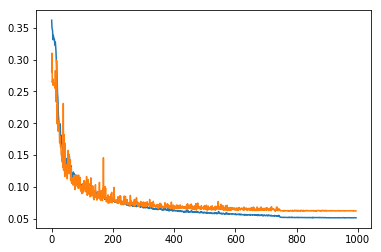

In [19]:
plt.plot(callback_list[1].history['train_loss'][5:])
plt.plot(callback_list[1].history['val_loss'][5:])

In [20]:
checkpoint = torch.load('../results/resnet/resnet-34-1c.pth-best.tar')

## Loading the best model

In [21]:
from cpe775.utils.img_utils import show_landmarks_batch

In [22]:
net = resnet34(in_shape=(-1, 1, 224, 224), out_shape=(-1, 68, 2))

In [23]:
best_model = Model(net)
best_net = model.net
best_net.load_state_dict(checkpoint['state_dict'])

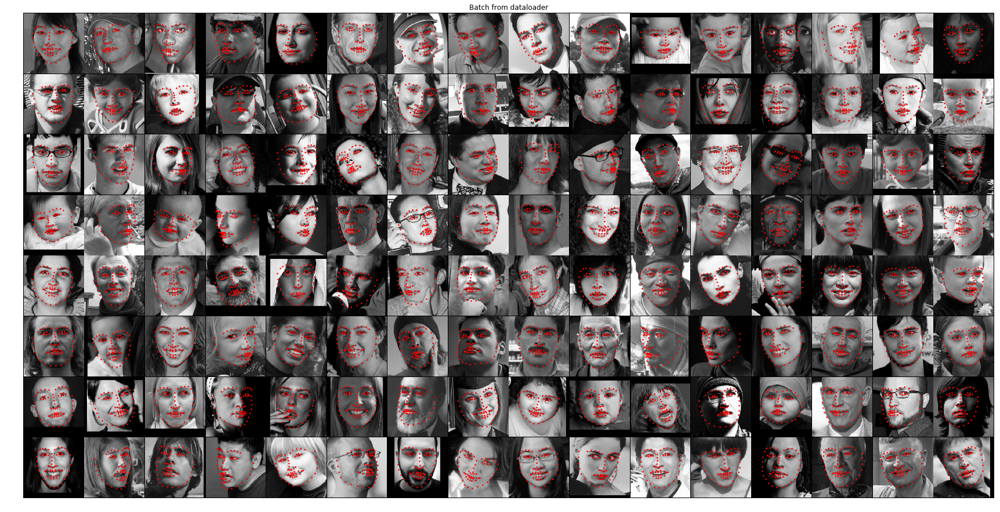

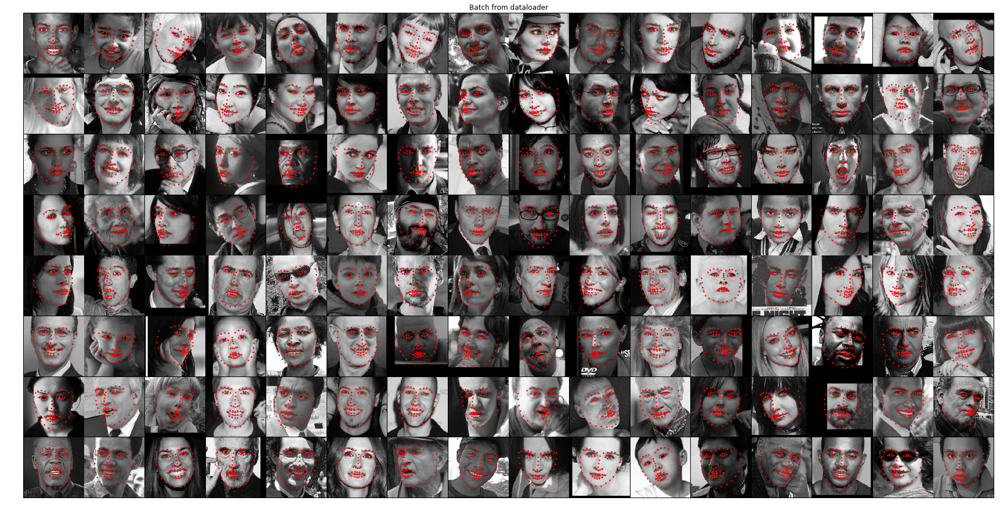

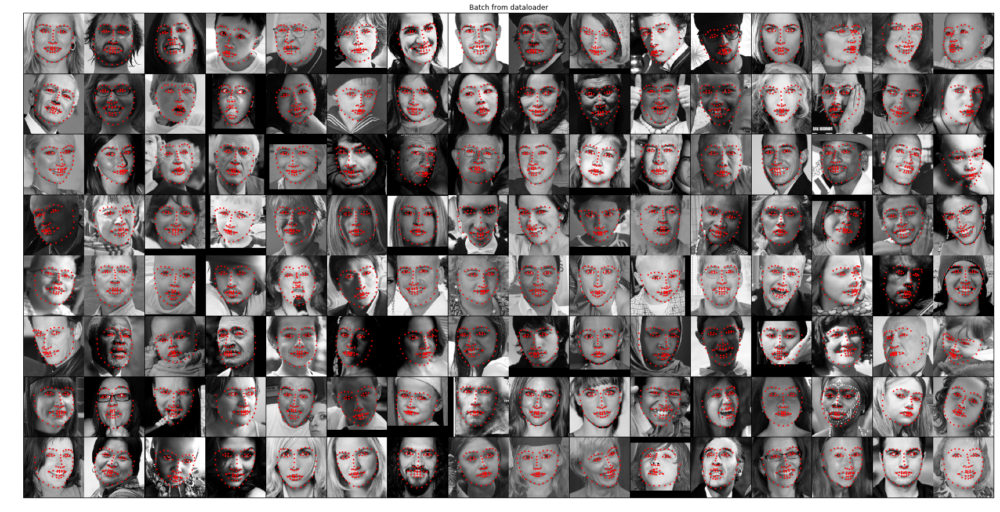

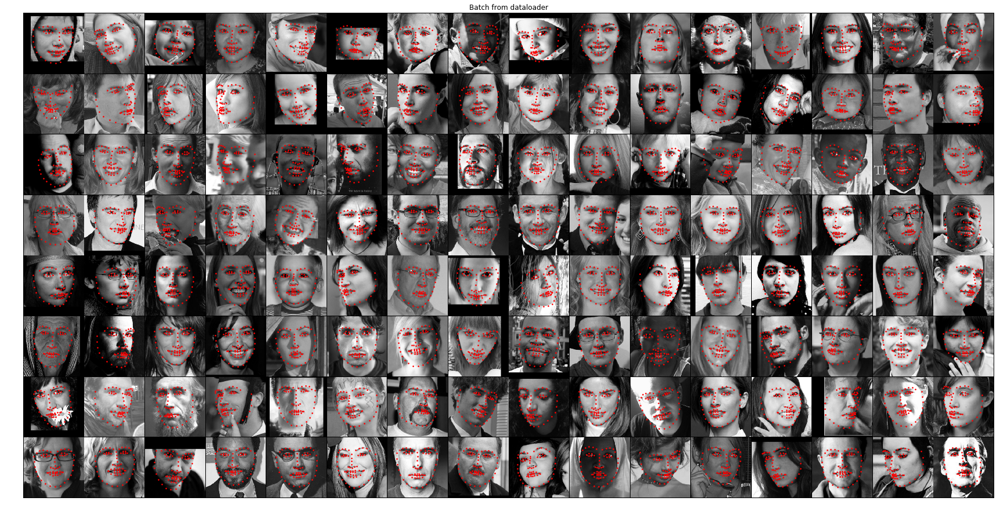

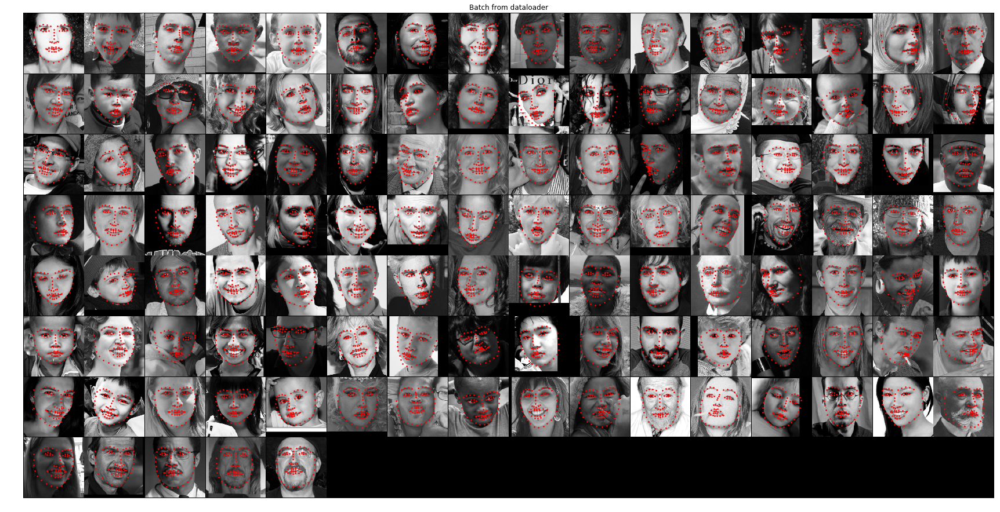

In [24]:
for i_batch, sample_batched in enumerate(valid_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data

    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)

    plt.axis('off')
    plt.ioff()
    plt.show()

### Common test

In [25]:
transforms = Compose([
                   CropFace(),
                   CenterCrop((224,224)),
                   ToGray(),
                   ToTensor()
                 ])

In [26]:
# load the dataset
dataset = FaceLandmarksDataset(csv_file='../data/common_test.csv',
                               root_dir='../data/',
                               transform=transforms)

common_loader = torch.utils.data.DataLoader(dataset, 
                batch_size=batch_size, num_workers=4)

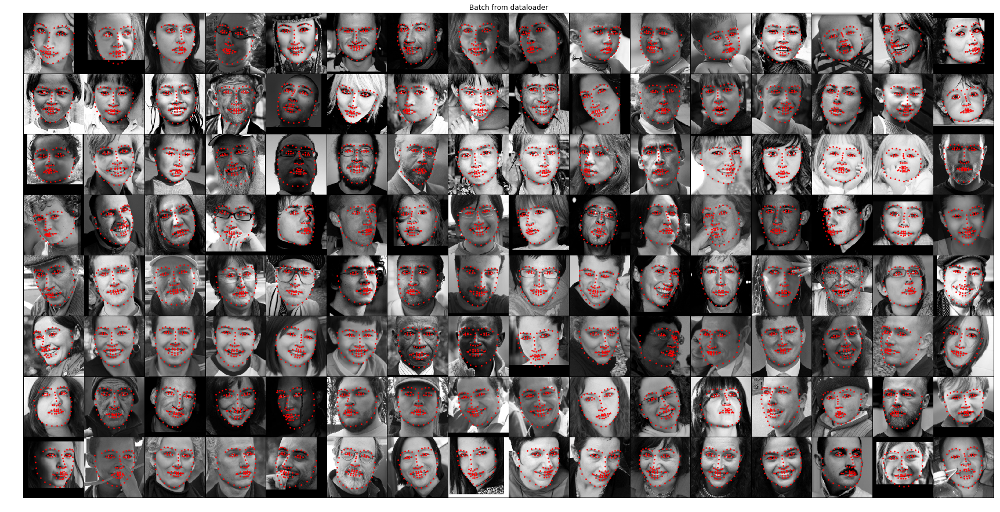

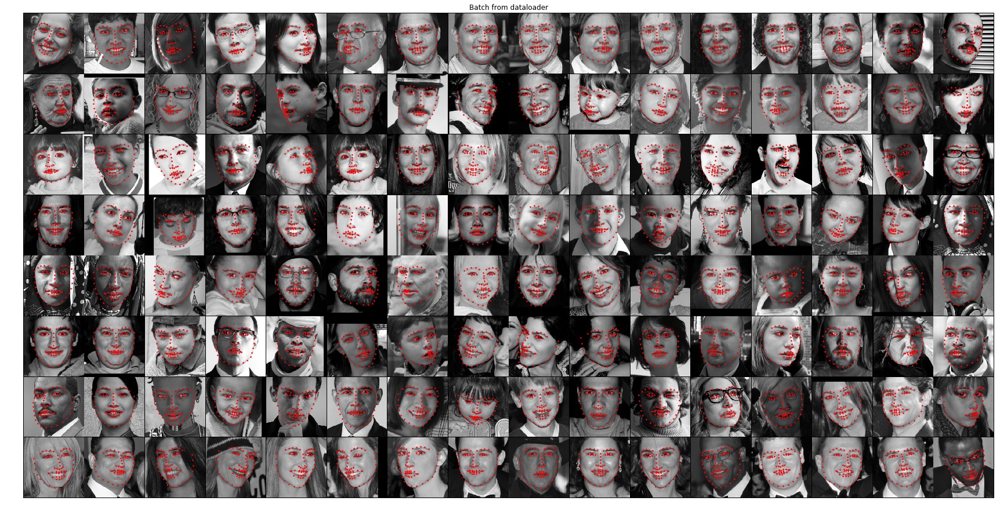

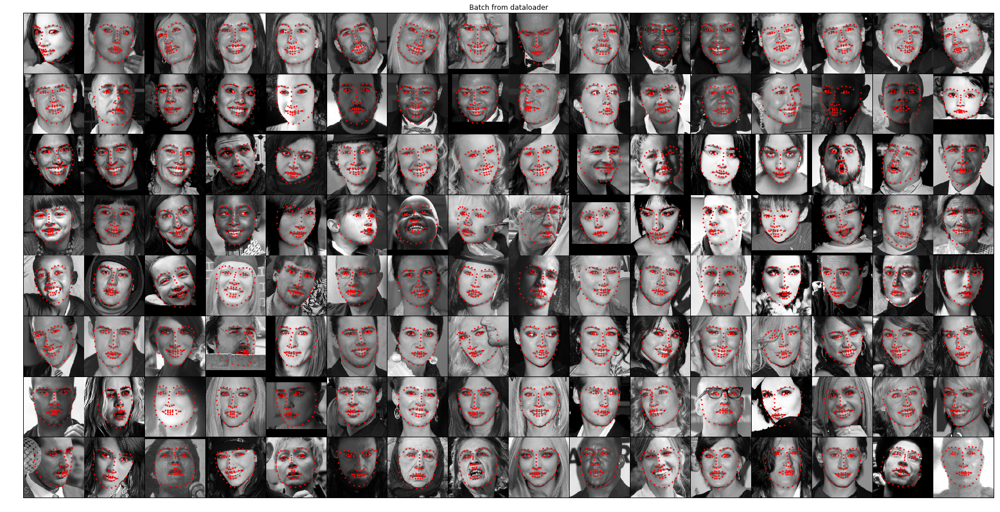

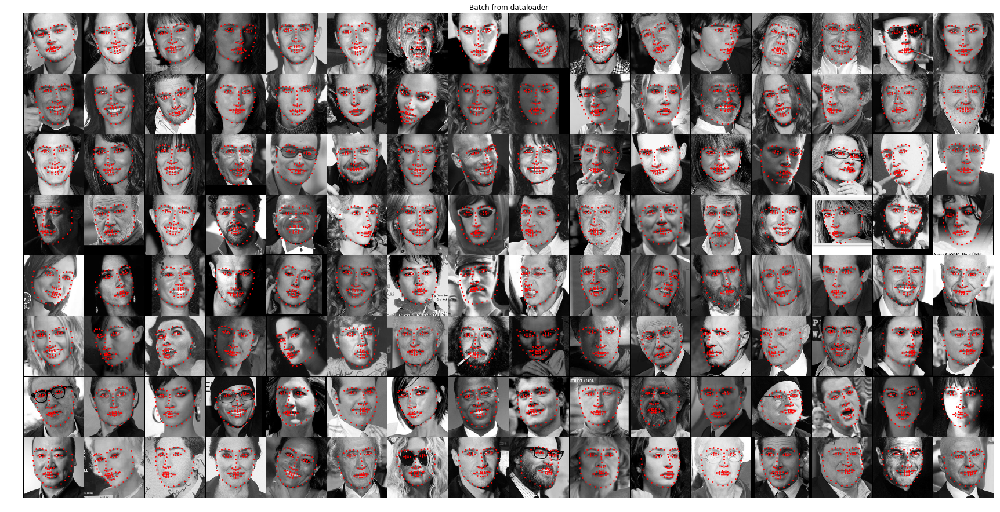

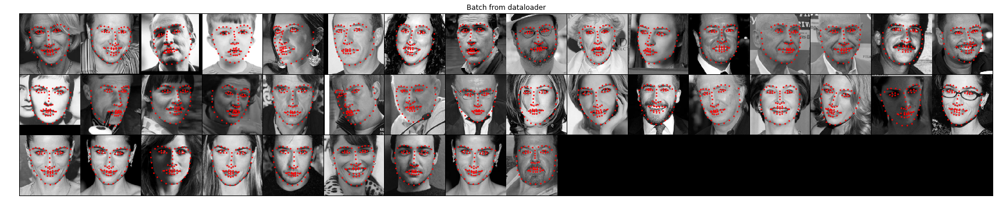

In [27]:
loss = 0
for i_batch, sample_batched in enumerate(common_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [28]:
loss/len(dataset)*68

3.922098799004046

### Challenging test

In [29]:
# load the dataset
challenging_set = FaceLandmarksDataset(csv_file='../data/challenging_test.csv',
                               root_dir='../data/',
                               transform=transforms)

challeging_loader = torch.utils.data.DataLoader(challenging_set, 
                batch_size=batch_size, num_workers=4)

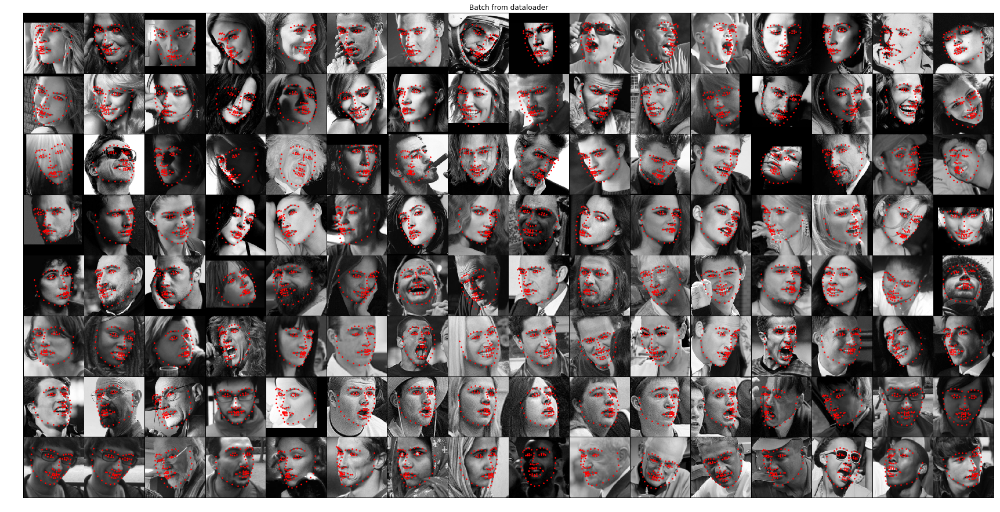

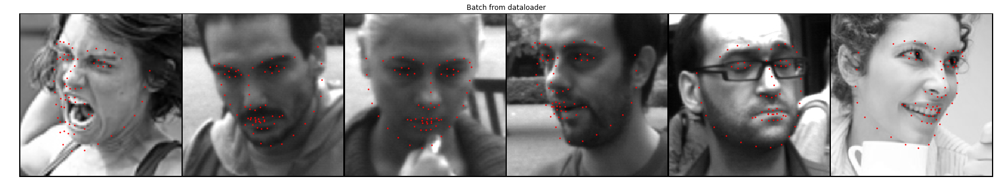

In [30]:
loss = 0
for i_batch, sample_batched in enumerate(challeging_loader):
    
    predicted_landmarks = best_net(torch.autograd.Variable(sample_batched['image'], volatile=False)).cpu().data
    
    loss += predicted_landmarks.shape[0]*criterion(predicted_landmarks, sample_batched['landmarks'])
    
    plt.figure(figsize=(30,18))
    show_landmarks_batch({'image': sample_batched['image'], 'landmarks': predicted_landmarks}, nrow=16)
    plt.axis('off')
    plt.ioff()
    plt.show()

In [31]:
loss/len(challenging_set)*68

8.934984600588457